# Climate Change Tweet Classification

---
## Predict Overview

### Climate change tweet classification Competition

EDSA has presented a challenge to create a Machine Learning model that can classify whether individuals believe in climate change or not based on their tweets. By developing an accurate and reliable solution, companies can gain valuable insights into consumer sentiment across various demographics and geographic locations. This information can inform their marketing strategies and help them understand how their environmentally friendly products or services may be received by different target audiences.

<a id="cont"></a>

## Table of Contents
    
<a href=#one>1. Introduction</a>
    
<a href=#two>2. Problem Statement</a>
   
<a href=#three>3. Hypothesis</a>

<a href=#four>4. Importing packages</a>

<a href=#five>5. Loading the Data</a>

<a href=#six>6. Exploratory Data Analysis (EDA)</a>

<a href=#seven>7. Data Engineering</a>

<a href=#eight>8. Modeling</a>

<a href=#nine>9. Model Performance</a>
    
<a href=#ten>10. Model Explanation</a>

<a href=#eleven>11. Conclusion</a>

<a href=#twelve>12. References</a>

<a id="one"></a>
## 1. Introduction
<a href=#cont>Back to Table of Contents</a>

---

In today's business landscape, numerous companies are dedicated to minimizing their environmental impact and reducing carbon footprints. Aligned with their core values, these companies strive to offer environmentally friendly and sustainable products and services. To enhance their market research endeavors and assess the potential reception of their offerings, they seek to understand public perceptions of climate change and its existence as a genuine threat. In this context, EDSA presents a challenge during the Classification Sprint: the development of a Machine Learning model capable of classifying individuals' belief in climate change based on their unique tweet data. Meeting this challenge successfully provides companies with a valuable tool to tap into a wide range of consumer sentiments, covering diverse demographics and geographic regions. Ultimately, this valuable insight empowers businesses to shape future marketing strategies more effectively."

<a id="two"></a>
## 2. Problem Statement
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>
    
---
To create a precise and efficient Machine Learning model that can classify individuals' belief in climate change based on their tweet data, providing companies with actionable insights to inform their marketing strategies and enhance their understanding of consumer sentiment.

<a id="three"></a>
## 3. Hypothesis
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>
--- 
By developing a Machine Learning model trained on novel tweet data, we can accurately classify individuals' belief in climate change. The model will effectively analyze the linguistic patterns, sentiment, and contextual cues within the tweets to determine whether a person believes in climate change or not. By leveraging this model, companies will gain access to valuable insights into consumer sentiment, enabling them to make data-driven decisions for their environmental sustainability-focused products and services."


<a id="four"></a>
## 4. Importing Packages
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
Let's start by importing the necessary packages that we will be using throughout the notebook.

Including external libraries or modules into our Python program. Packages contain pre-defined functions, classes, and variables that can be used to extend the functionality of Python.

In [1]:
import numpy as np         # library for mathematical functions and array manipulation
import pandas as pd        # library for data manipulation and analysis
import matplotlib.pyplot as plt  # module for data visualization
import seaborn as sns      # library for  enhanced data visualization
%matplotlib inline

import os
import re        # module for regular expression operations
import csv
import nltk      # library for natural language processing tasks
import spacy     # library for advanced natural language processing
import string
import pickle    # module for object serialization
import matplotlib.style as style # module from matplotlib for customizing plot styles
import missingno as msno
import json

# Style
import plotly.express as px

sns.set(font_scale=1.5)
style.use('seaborn-pastel')
style.use('seaborn-poster')
from PIL import Image
from wordcloud import WordCloud

# Downloads
nlp = spacy.load('en_core_web_sm')
nlp = spacy.blank('en')
nlp = spacy.blank('zh')
nlp = spacy.blank('xx') # multilanguage (spaCy provides support for languages)
nltk.download('punkt')
nltk.download('wordnet') # dataset from NLTK
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')
from nltk.stem import PorterStemmer

# Preprocessing
from collections import Counter
from nltk.probability import FreqDist
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords, wordnet
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, TfidfTransformer
from sklearn.model_selection import train_test_split, RandomizedSearchCV

# Building classification models
from sklearn.utils import resample
from sklearn.svm import LinearSVC
from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import LabelEncoder

# Model evaluation
from sklearn import metrics
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score, precision_score, recall_score

from powerbiclient import Report, models
from io import StringIO
from ipywidgets import interact
import requests
from PIL import Image
    
#Natural Language Took Kit
from nltk.stem.porter import PorterStemmer
from nltk import word_tokenize, WordNetLemmatizer
from nltk.tokenize import word_tokenize
from nltk.tokenize.treebank import TreebankWordDetokenizer as Detok
from nltk.corpus import stopwords
nltk.download('wordnet')
nltk.download('punkt')
from tqdm import tqdm
nltk.download('averaged_perceptron_tagger')
    
from spacy.util import compounding
from spacy.util import minibatch

[nltk_data] Downloading package punkt to C:\Users\Ayanda
[nltk_data]     Thembelihle\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to C:\Users\Ayanda
[nltk_data]     Thembelihle\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to C:\Users\Ayanda
[nltk_data]     Thembelihle\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Ayanda
[nltk_data]     Thembelihle\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to C:\Users\Ayanda
[nltk_data]     Thembelihle\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to C:\Users\Ayanda
[nltk_data]     Thembelih

<a id="five"></a>
## 5. Loading the Data
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

In this section, we load the data given in a form of a CSV file so that we can leverage the power of programming and data analysis tools to work with the data, extract insights, and perform further tasks as needed

In [2]:
# Making sure that we can see all the rows and columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

# Reading the training data from a CSV file
train_df = pd.read_csv('train.csv')
    
# Reading the test data from a CSV file
test_df = pd.read_csv('test_with_no_labels.csv')

<a id="six"></a>
## 6. Exploratory Data Analysis (EDA)
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
To gain insights into the dataset, we will perform Exploratory Data Analysis (EDA).

EDA is an essential part of the project life cycle in data analysis and data science. It involves examining and understanding the data before diving into any modeling or analysing tasks.
This includes visualizing the distribution of the target variable and exploring any patterns or trends in the data.

Here, we:
- Maximize our natural pattern-recognition abilities to extract insights.
- Uncover underlying structure (e.g skewness).
- Extract important variables and find interesting relations among the variables.

In [3]:
# Checking the shape of the train and test data\n",
print(f' There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in the Train data')
print(f' There are {test_df.shape[0]} rows and {test_df.shape[1]} columns in the Test data')

 There are 15819 rows and 3 columns in the Train data
 There are 10546 rows and 2 columns in the Test data


In [4]:
# Reading the data of the train
print("Train data")
display(train_df.head())
    
# Reading the data of the test
print("Test data")
display(test_df.head())

Train data


,sentiment,message,tweetid
0,1,"PolySciMajor EPA chief doesn't think carbon dioxide is main cause of global warming and.. wait, what!? https://t.co/yeLvcEFXkC via @mashable",625221
1,1,It's not like we lack evidence of anthropogenic global warming,126103
2,2,RT @RawStory: Researchers say we have three years to act on climate change before it’s too late https://t.co/WdT0KdUr2f https://t.co/Z0ANPT…,698562
3,1,#TodayinMaker# WIRED : 2016 was a pivotal year in the war on climate change https://t.co/44wOTxTLcD,573736
4,1,"RT @SoyNovioDeTodas: It's 2016, and a racist, sexist, climate change denying bigot is leading in the polls. #ElectionNight",466954


Test data


,message,tweetid
0,Europe will now be looking to China to make sure that it is not alone in fighting climate change… https://t.co/O7T8rCgwDq,169760
1,Combine this with the polling of staffers re climate change and womens' rights and you have a fascist state. https://t.co/ifrm7eexpj,35326
2,"The scary, unimpeachable evidence that climate change is already here: https://t.co/yAedqcV9Ki #itstimetochange #climatechange @ZEROCO2_;..",224985
3,@Karoli @morgfair @OsborneInk @dailykos \nPutin got to you too Jill ! \nTrump doesn't believe in climate change at all \nThinks it's s hoax,476263
4,RT @FakeWillMoore: 'Female orgasms cause global warming!'\n-Sarcastic Republican,872928


The datasets aggregates tweets pertaining to climate change collected between Apr 27, 2015 and Feb 21, 2018.

The train data is structured as:
* `sentiment`: The belief of individuals regarding climate change. Sentiment of the tweet i.e -1, 0, 1, 2
* `message`: The text of the tweets associated with each entry.
* `tweetid`: The tweet unique identifier

The sentiments of the test data is the prediction target.

In [5]:
# Displaying the unique sentiment categories
display(np.sort(train_df['sentiment'].unique()))

array([-1,  0,  1,  2], dtype=int64)

Sentiment Description:
- `-1`: Anti  -  the tweet does not believe in man-made climate change
- `0`: Neutral -  the tweet neither supports nor refutes the belief of man-made climate change
- `1`: Pro - the tweet supports the belief of man-made climate change
- `2`: News - the tweet links to factual news about climate change

In [6]:
# Printing the count of tweets for each sentiment
sorted_sentiment = train_df['sentiment'].value_counts().sort_index()
print(sorted_sentiment)

sentiment
-1    1296
 0    2353
 1    8530
 2    3640
Name: count, dtype: int64


- 1296 tweets do not believe in climate change
- 2353 tweets neither support nor refute the belief of man-made climate change
- 8530 tweets support the belief of man-made climate change
- 3640 tweets are linked to factual news about climate change.

In [7]:
# Checking the datatype of each column in the train data
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15819 entries, 0 to 15818
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   sentiment  15819 non-null  int64 
 1   message    15819 non-null  object
 2   tweetid    15819 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 370.9+ KB


- The data type of `sentiment` and `tweetid` is 'int64', which indicates that these variables contain numeric data.
- Whereas, the data type of `message` is 'object', which indicates that this variable contains non-numeric data.

#### Checking for missing values

In [8]:
# Checking the number of missing data for each column in the Train data
train_df.isnull().sum()

sentiment    0
message      0
tweetid      0
dtype: int64

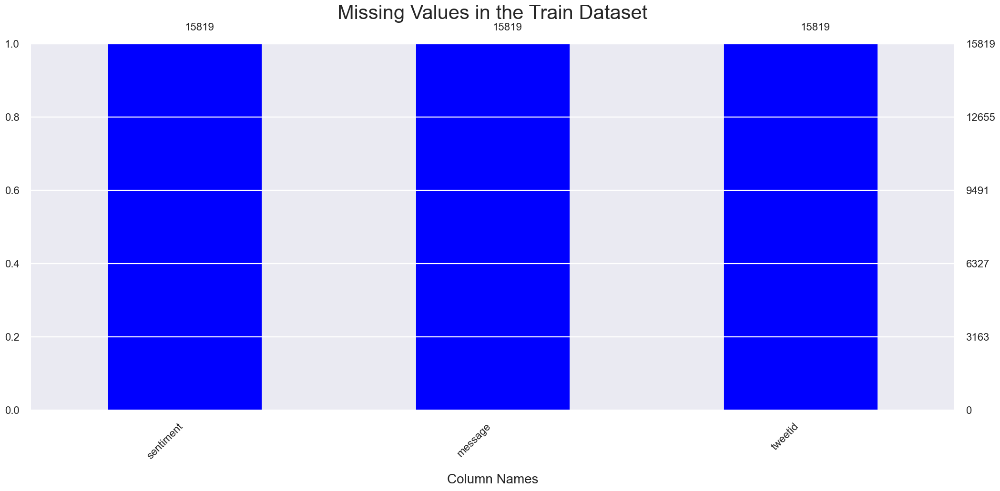

In [9]:
# Visualising the null values (missing values)
msno.bar(train_df, color='blue')
plt.title('Missing Values in the Train Dataset',fontsize=30)

plt.xlabel('Column Names',fontsize=20)
plt.ylabel('Percentage of Missing Values')

# Rotating the bar labels to horizontal
plt.xticks(rotation='horizontal')

# Adjusting the position of x-axis ticks and labels
plt.gca().xaxis.set_label_coords(0.5, -0.2) # Set the label position at the bottom

plt.show()

In [10]:
# Checking the number of missing data for each column in the Test data
test_df.isnull().sum()

message    0
tweetid    0
dtype: int64

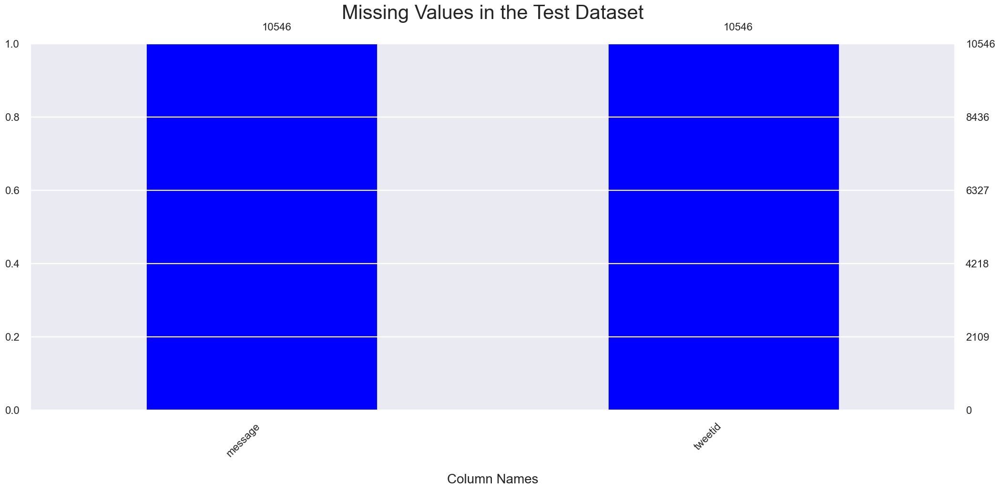

In [11]:
# Visualising the null values (missing values)
msno.bar(test_df, color='blue')
plt.title('Missing Values in the Test Dataset',fontsize=30)
    
plt.xlabel('Column Names',fontsize=20)
plt.ylabel('Percentage of Missing Values')

# Rotating the bar labels to horizontal
plt.xticks(rotation='horizontal')

# Adjusting the position of x-axis ticks and labels
plt.gca().xaxis.set_label_coords(0.5, -0.2) # Set the label position at the bottom

plt.show()

- Both the train and test datasets have no missing values.

#### Checking for duplicates

In [12]:
# Looking for duplicates in the train data
percent_duplicates = round((1-(train_df['message'].nunique()/len(train_df['message'])))*100,2)
print('Duplicated tweets in train data:')
print(percent_duplicates,'%')

Duplicated tweets in train data:
10.05 %


- approximately 10% of tweets are duplicated in the train data.

#### Converting the Sentiment feature

In [13]:
# Updating the sentiment from numbers to their respective categories\n",
def update(df):
    df = train_df.copy()
    sentiment = df['sentiment']
    word_sentiment = []
    for i in sentiment :
        if i == 1 :
            word_sentiment.append('Pro')
        elif i == 0 :
            word_sentiment.append('Neutral')
        elif i == -1 :
            word_sentiment.append('Anti')
        else :
            word_sentiment.append('News')

    df['sentiment'] = word_sentiment
    
    return df

df = update(train_df)
df.head()

,sentiment,message,tweetid
0,Pro,"PolySciMajor EPA chief doesn't think carbon dioxide is main cause of global warming and.. wait, what!? https://t.co/yeLvcEFXkC via @mashable",625221
1,Pro,It's not like we lack evidence of anthropogenic global warming,126103
2,News,RT @RawStory: Researchers say we have three years to act on climate change before it’s too late https://t.co/WdT0KdUr2f https://t.co/Z0ANPT…,698562
3,Pro,#TodayinMaker# WIRED : 2016 was a pivotal year in the war on climate change https://t.co/44wOTxTLcD,573736
4,Pro,"RT @SoyNovioDeTodas: It's 2016, and a racist, sexist, climate change denying bigot is leading in the polls. #ElectionNight",466954


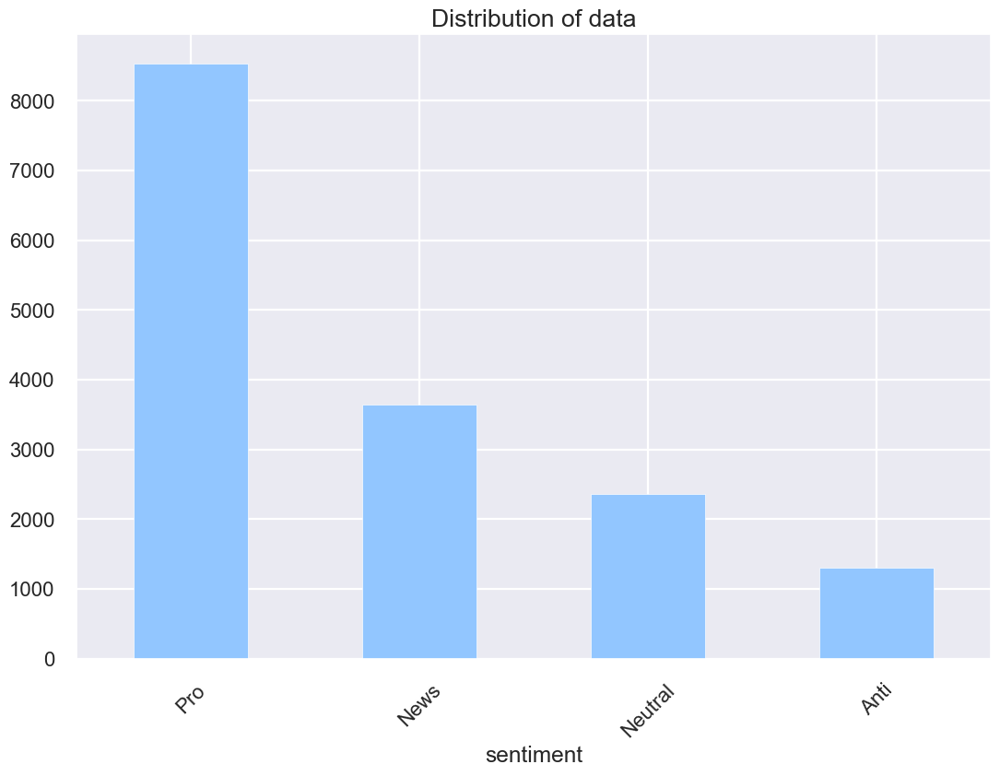

In [14]:
# Plotting the distribution of the 'sentiment' column in the 'data' DataFrame
ax = df['sentiment'].value_counts().plot(kind='bar', title='Distribution of data')

# Setting custom labels for x-axis ticks
ax.set_xticklabels(['Pro', 'News', 'Neutral', 'Anti'], rotation=45)
plt.show()

### Target variable distribution

In [ ]:
# Displaying the target distribution using the bar plots and pie chart
style.use('seaborn-pastel')

fig, axes = plt.subplots(ncols=2, 
                         nrows=1, 
                         figsize=(20, 10), 
                         dpi=100)

#sns.countplot(df['sentiment'], ax=axes[0])

labels=['Pro', 'News', 'Neutral', 'Anti'] 

axes[1].pie(df['sentiment'].value_counts(),
            labels=labels,
            autopct='%1.0f%%',
            shadow=True,
            startangle=90,
            explode = (0.1, 0.1, 0.1, 0.1))

fig.show()

- 54% of the data is positively reacting to climate change, whilst negative reactions amount to 8%.
- News account for 23% of the data, and neutral tweets are 15%.

- Taking a closer look at the distribution of the tweets we notice that the data is severely imbalanced with the majority of tweets falling in the 'pro' category, supporting the belief of man-made climate change.

In [16]:
# Displaying the target distribution using the funnel chart
fig = px.funnel(df, x='sentiment', y='message',color='sentiment')
fig.show()

- The funnel chart paints a clearer picture of the distribution of tweets and reveals that the train dataset is imbalanced.
- This imbalance will be dealt with at the later stage of modeling

#### Tweet length distribution 

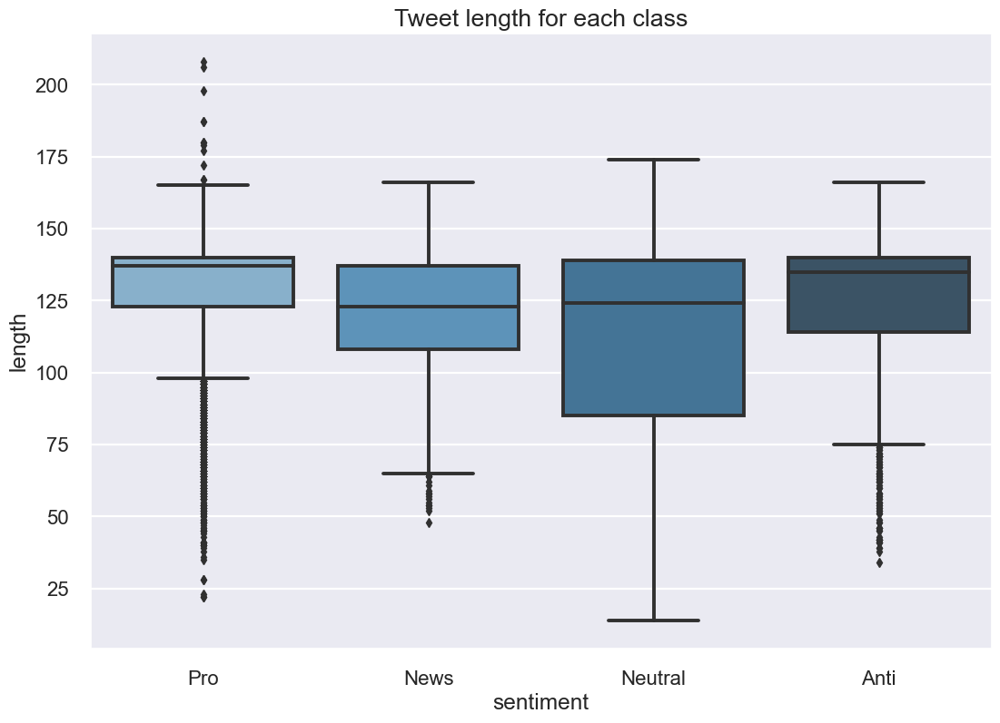

In [17]:
# Plotting the distribution of the length tweets for each class using a box plot
df['length'] = df['message'].apply(len)
sns.boxplot(x=df['sentiment'], y=df['length'], data=df, palette=("Blues_d"))
plt.title('Tweet length for each class')
plt.show()

- From the box plots, we can see that tweets that fall in the "Pro" climate change class are generally longer and the shortest tweets belong to the "Anti" climate change class.
- We also notice that "Neutral" climate change tweets tend to have the most variability in tweet length.

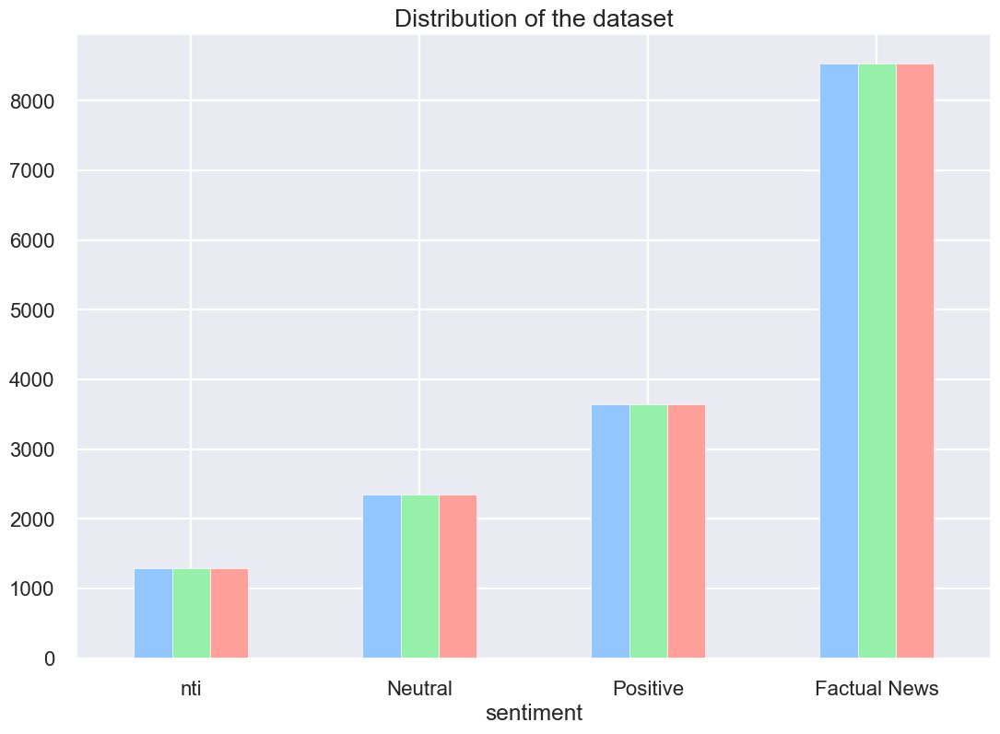

In [18]:
# Plotting the count of tweets for each sentiment for the dataset using a bar graph 
ax = df.groupby('sentiment').count().plot(kind='bar', title='Distribution of the dataset', legend=False)
ax.set_xticklabels(['nti','Neutral', 'Positive','Factual News'], rotation=0)

text, sentiment = list(df['message']), list(df['sentiment'])

- From the bar graph above, we notice that the majority of tweets fall in the 'Factual News' category about climate change. Whereas, a few tweets fall in the 'Negative' category."

### Data Distribution

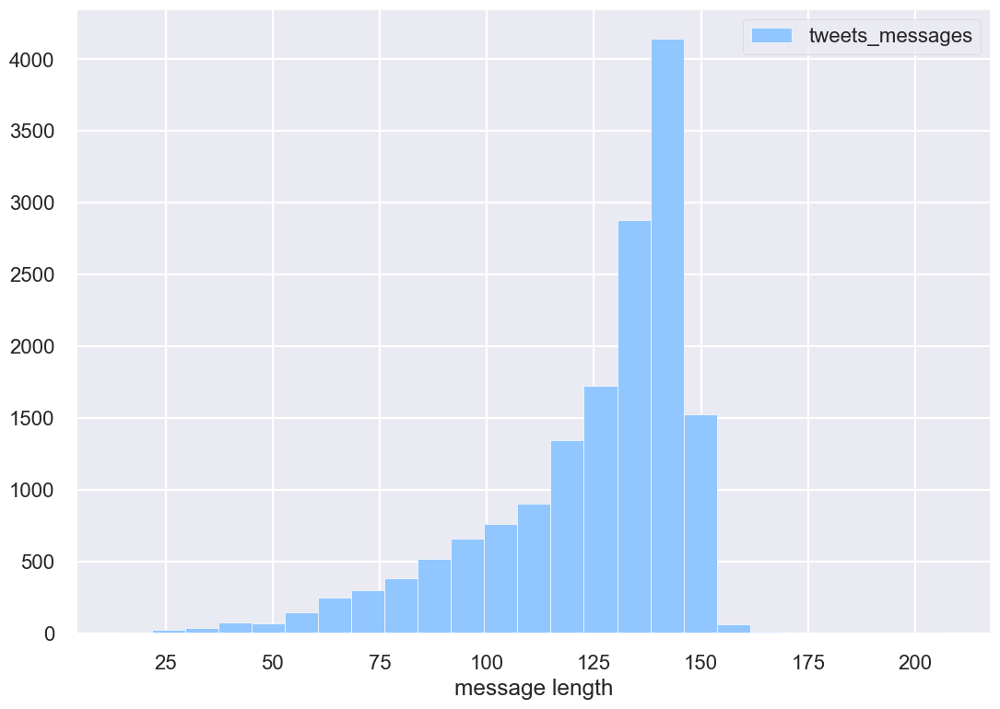

In [19]:
# Plotting the distribution of the message lengths for the dataset using a histrogram
length_data = df['message'].str.len()

plt.hist(length_data, bins=25, label="tweets_messages")
plt.xlabel('message length')
plt.legend()
plt.show()

- From the histogram above, a large number of tweets have longer message lengths and a few have short message lengths.

#### Density Curve

A density curve is a curve on a graph that represents the distribution of values in a dataset. It gives us a good idea of the “shape” of a distribution, including whether or not a distribution has one or more “peaks” of frequently occurring values and whether or not the distribution is skewed to the left or the right.

<AxesSubplot:xlabel='message', ylabel='Density'>

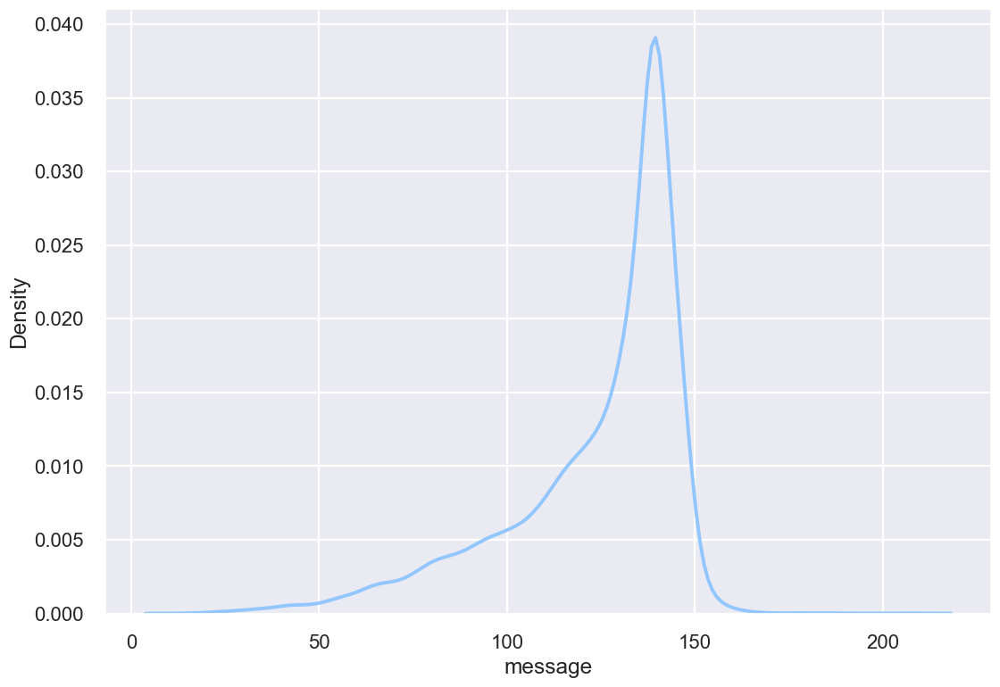

In [20]:
# Length of the Text using KDEplot
text_length = df["message"].str.len()
sns.kdeplot(text_length)

- The curve is skewed to the left side of the distribution, since a large number of tweets have longer message lengths.
- It is lowest near the ends of the distribution, because a few have short message lengths.

### Word Cloud Visualization

In [21]:
# Creating word clouds for pro, anti, and neutral tweets
pro_wordcloud = WordCloud().generate(" ".join(df[df['sentiment'] == 'Pro']['message']))
anti_wordcloud = WordCloud().generate(" ".join(df[df['sentiment'] == 'Anti']['message']))
neutral_wordcloud = WordCloud().generate(" ".join(df[df['sentiment'] == 'Neutral']['message']))
news_wordcloud = WordCloud().generate(" ".join(df[df['sentiment'] == 'News']['message']))

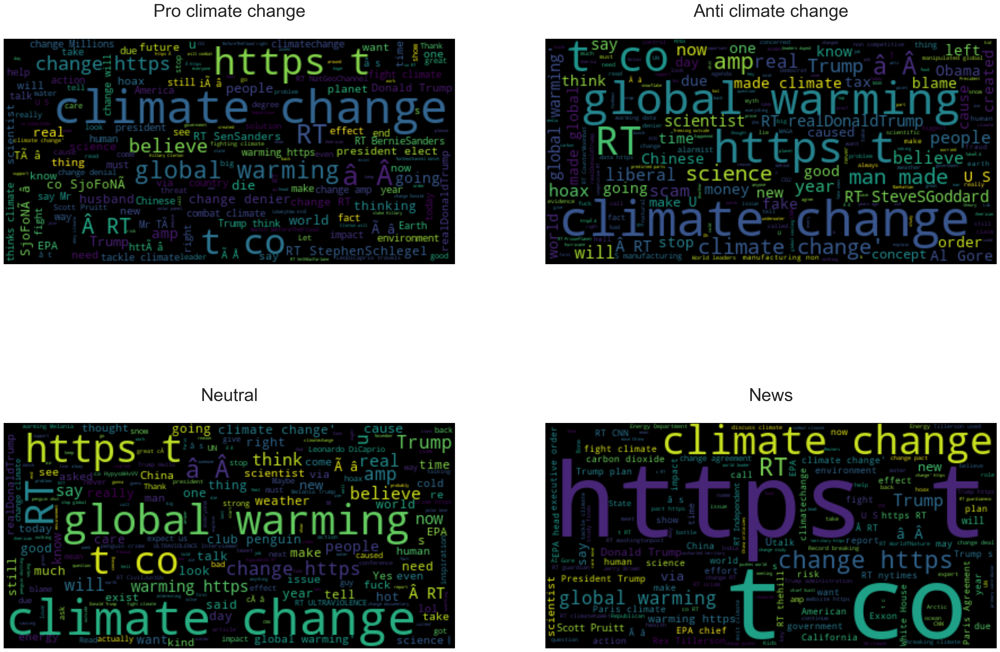

In [22]:
# Plotting pro and anti wordclouds next to one another for comparisson
f, axarr = plt.subplots(2,2, figsize=(35,25))
axarr[0,0].imshow(pro_wordcloud, interpolation="bilinear")
axarr[0,1].imshow(anti_wordcloud, interpolation="bilinear")
axarr[1,0].imshow(neutral_wordcloud, interpolation="bilinear")
axarr[1,1].imshow(news_wordcloud, interpolation="bilinear")

# Removing the ticks on the x and y axes
for ax in f.axes:
    plt.sca(ax)
    plt.axis('off')

axarr[0,0].set_title('Pro climate change\n', fontsize=35)
axarr[0,1].set_title('Anti climate change\n', fontsize=35)
axarr[1,0].set_title('Neutral\n', fontsize=35)
axarr[1,1].set_title('News\n', fontsize=35)
#plt.tight_layout()
plt.show()

The Wordcloud Visualization displays the top 100 words from the message and sentiment columns.The size of the words is relative to the frequency of the word in the message column, meaning, the bigger the word the more frequently it appeared.

* ##### Tweets under Pro climate change

Common words in pro-sentiment include `climate change, https, RT,CO Believe, thinking`

* ##### Tweets under Neutral 

Common words in neutral tweets include `global warming, climate change, Https,Rt, believe, think, real, people`. This could indicate uncerainty toward climate change validity or an apathetic inclination.

* ##### Tweets under Anti climate change

Common words in anti- sentiment include `Co, RT, Https, Trump, man made, global warming`. The common appearance of the words `liberal`,`was created`,`created by`,`fake`,`man made` and `crime` is an indication of a negative sentiment. Some of the common words shows a belief of conspiracy, words like `hoax, Chinese, manipulated`.

* ##### Tweets under News

 Common words news tweets are `Co, RT, Https, Trump, global warming, Scientists, researchers, ÈPA and reports`. This could reveal the sentiment that humans are the cause of climate change. The frequence of `reports` could be that many rely of the media to validate their beliefs.
 
There many retweets in the above dataframe. Retweets are repetions of an original post on twitter shared by different users. The former USA President, Donald `Trump`, appears often in all classes due to his administration's "controversial" stance on global warming, with Twitter being his source of communication during his presidency.

### Hashtags

Hashtags have long been an important tool on Twitter for helping users organize and sort their tweets. They're a great way to indicate that your content is relevant to a certain topic and to get your tweets in front of an interested audience.

Considering this, we decided it might be insightful to see what the most frequent hashtags in each class are. This will help us gain a better understanding of what kind of information is being consumed and shared in each class.

In [23]:
# Creating a function that will produce hashtags and their respective counts
def hashtag_extract(tweet):
    hashtags = []
    for i in tweet:
        ht = re.findall(r"#(\w+)", i)
        hashtags.append(ht)
        
    hashtags = sum(hashtags, [])
    frequency = nltk.FreqDist(hashtags)
    
    hashtag_df = pd.DataFrame({'hashtag': list(frequency.keys()),
                       'count': list(frequency.values())})
    hashtag_df = hashtag_df.nlargest(15, columns="count")

    return hashtag_df

# Extracting the hashtags from tweets in each class
pro = hashtag_extract(df['message'][df['sentiment'] == 'Pro'])
anti = hashtag_extract(df['message'][df['sentiment'] == 'Anti'])
neutral = hashtag_extract(df['message'][df['sentiment'] == 'Neutral'])
news = hashtag_extract(df['message'][df['sentiment'] == 'News'])

pro.head()

,hashtag,count
19,climate,187
24,BeforeTheFlood,129
68,climatechange,94
13,ImVotingBecause,62
4,COP22,59


- #climate has the highest number of counts

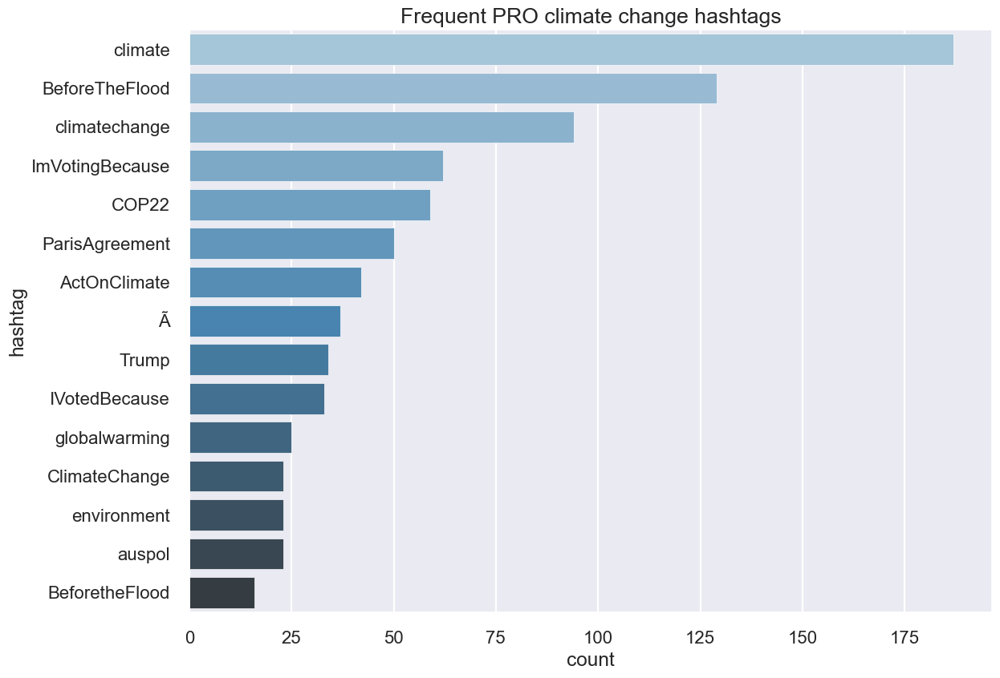

In [24]:
# Plotting the frequent hashtags for pro climate change classes
sns.barplot(data=pro,y=pro['hashtag'], x=pro['count'], palette=("Blues_d"))
plt.title('Frequent PRO climate change hashtags')
plt.tight_layout()

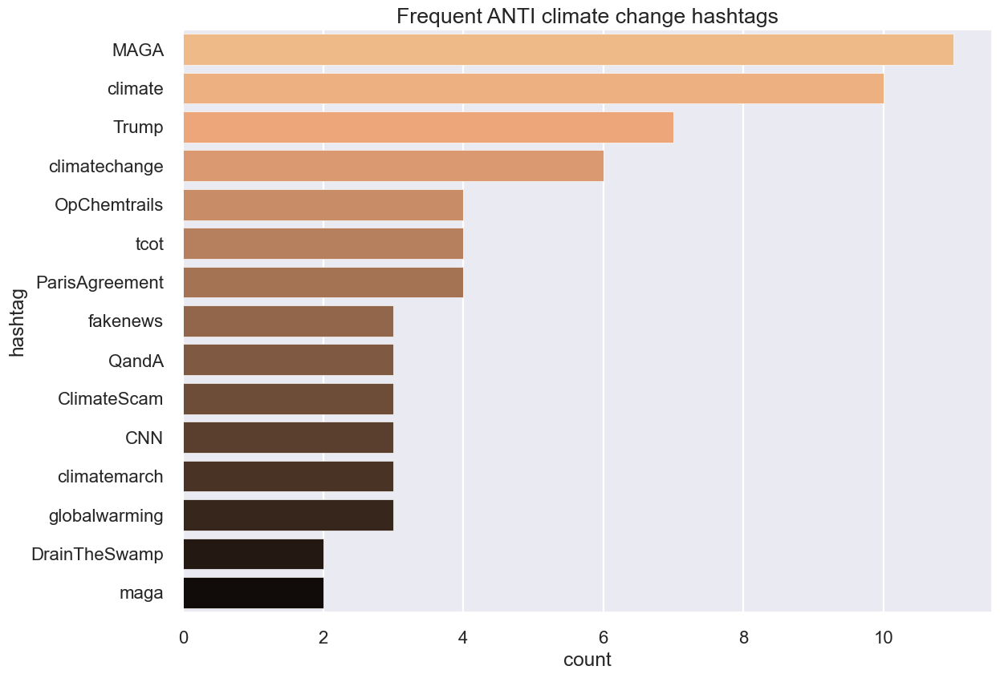

In [25]:
# Plotting the frequent hashtags for anti climate change classes \n",
sns.barplot(data=anti,y=anti['hashtag'], x=anti['count'], palette=("copper_r"))
plt.title('Frequent ANTI climate change hashtags')
plt.tight_layout()

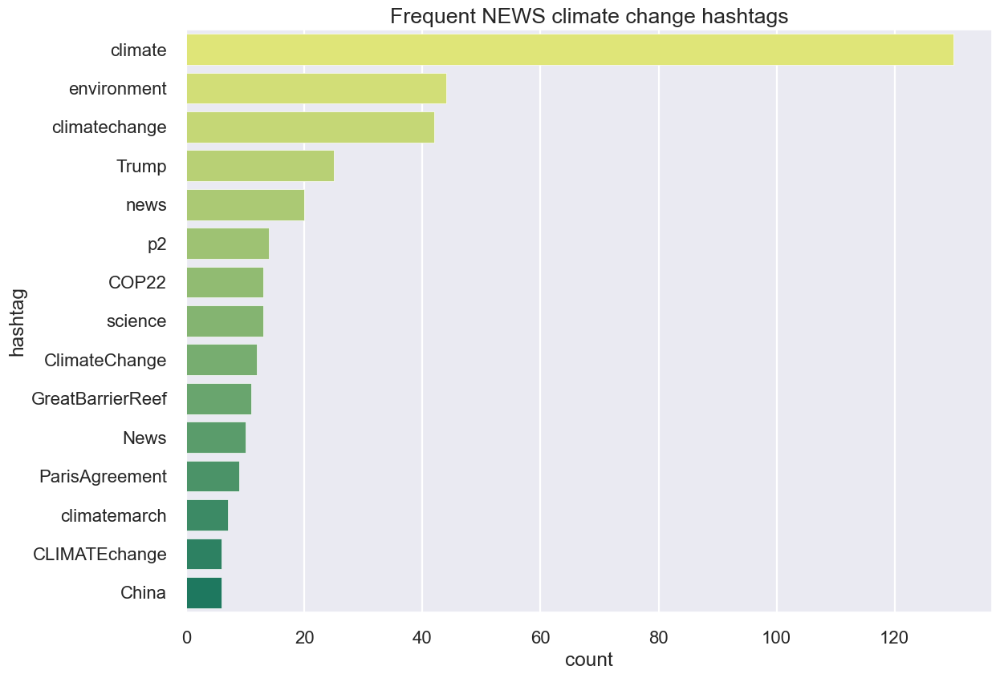

In [26]:
# Plotting the frequent hastags for the news climate change classes
sns.barplot(y=news['hashtag'], x=news['count'], palette=("summer_r"))
plt.title('Frequent NEWS climate change hashtags')
plt.tight_layout()

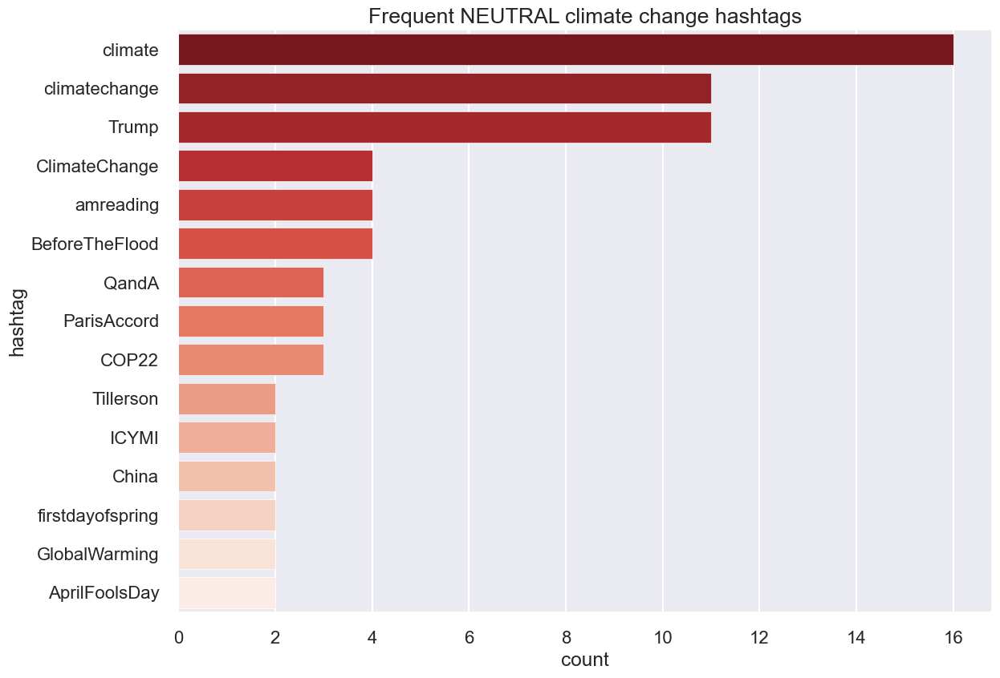

In [27]:
# Plotting the frequent hastags for the neutral climate change classes
sns.barplot(y=neutral['hashtag'], x=neutral['count'], palette=("Reds_r"))
plt.title('Frequent NEUTRAL climate change hashtags')
plt.tight_layout()

The graphs show the most common hashtags.

* `Climate` is the most common hashtag in all the climate change class graphs with the exception of anti climate change class , however it is worth noting some of the hashtags `BeforeTheFlood`, `ParisAgreement`, `ActOnClimate`. 
- The count of these three hashtags could be an indication of how serious climate change believers view the topic.

* The most common word on anti-climate change graph is `MAGA` which means "Make America Great Again", a slogan commonly associated with USA former President Donald Trump. Some of the other common hashtags included `Trump`, `fakenews`, `ClimateScam`.
- Another hashtag caught our attention `ParisAgreement` on how it would appear on the anti hashtags, upon further research we discovered that in order to "Make America Great Again" , Donald Trump believed the `ParisAgreement` was not beneficial to the United States and formally withdrew from it.

<a id="seven"></a>
## 7. Data Engineering
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

Before we can build our model, we need to preprocess and clean the text data. This involves removing any unnecessary characters, converting text to lowercase, and handling any missing values.\n",

In this section we will be focusing on preparing and transforming the raw data into a format that is suitable for analysis and model training. Handling missing values, handling outliers, feature selection and engineering.

### Data cleaning

Contractions need to be expanded into full text for standardization, this prevents the loss of words and meanings when punctuation is removed. This improves the machine's ability to read and interpret the data. A computer does not understand that contractions are abbreveations, for example it will consider `couldn't` and `could not` as two words that are completely different and will not recognise that the have same meaning.

Removing `hashtags, symbols, numbers and users` as it add no value to the data. Lowercasing all text data is very effective for consistency as models are case sensitive 

In [28]:
def TweetCleaner(tweet):
    # Convert everything to lowercase
    tweet = tweet.lower() 
    
    # Remove mentions   
    tweet = re.sub('@[\w]*','',tweet)  
    
    # Remove url's
    tweet = re.sub(r'https?:\/\/.*\/\w*', '', tweet)
    
    # Remove hashtags
    tweet = re.sub(r'#\w*', '', tweet)    
    
    # Remove numbers
    tweet = re.sub(r'\d+', '', tweet)  
    
    # Remove punctuation
    tweet = re.sub(r"[,.;':@#?!\&/$]+\ *", ' ', tweet)
    
    # Remove that funny diamond
    tweet = re.sub(r"U+FFFD ", ' ', tweet)
    
    # Remove extra whitespace
    tweet = re.sub(r'\s\s+', ' ', tweet)
    
    # Remove space in front of tweet
    tweet = tweet.lstrip(' ')                        
    
    return tweet

# Cleaning the tweets in the message column
df['message'] = df['message'].apply(TweetCleaner)
df['message'] = df['message'].apply(TweetCleaner)
df.head()

,sentiment,message,tweetid,length
0,Pro,polyscimajor epa chief doesn t think carbon dioxide is main cause of global warming and wait what via,625221,140
1,Pro,it s not like we lack evidence of anthropogenic global warming,126103,62
2,News,rt researchers say we have three years to act on climate change before it’s too late …,698562,140
3,Pro,wired was a pivotal year in the war on climate change,573736,99
4,Pro,rt it s and a racist sexist climate change denying bigot is leading in the polls,466954,122


#### Parts of speech (POS) tagging and lemmatization

In this step we start by determining the length of each tweet and storing this information in a new column. We then tokenize the tweets before performing POS tagging on each word followed by lemmatization.

In lemmatization, we reduce the word into dictionary root form. For instance "cats" is converted into "cat". 

Lemmatization is done in order to avoid creating features that are semantically similar but syntactically different. 

It is preferred over stemming since stemming is a crude method for cataloging related words; it essentially chops off letters from the end until the stem is reached. This works fairly well in most cases, but unfortunately English has many exceptions where a more sophisticated process is required

In [29]:
def lemma(df):
    df['length'] = df['message'].str.len()
    df['tokenized'] = df['message'].apply(word_tokenize)
    df['pos_tags'] = df['tokenized'].apply(nltk.tag.pos_tag)

    def get_wordnet_pos(tag):

        if tag.startswith('J'):
            return wordnet.ADJ

        elif tag.startswith('V'):
            return wordnet.VERB

        elif tag.startswith('N'):
            return wordnet.NOUN

        elif tag.startswith('R'):
            return wordnet.ADV
    
        else:
            return wordnet.NOUN
        
    wnl = WordNetLemmatizer()
    df['pos_tags'] = df['pos_tags'].apply(lambda x: [(word, get_wordnet_pos(pos_tag)) for (word, pos_tag) in x])
    df['lemmatized'] = df['pos_tags'].apply(lambda x: [wnl.lemmatize(word, tag) for word, tag in x])
    df['lemmatized'] = [' '.join(map(str, l)) for l in df['lemmatized']]  
    return df

df = lemma(df)
df.head()

,sentiment,message,tweetid,length,tokenized,pos_tags,lemmatized
0,Pro,polyscimajor epa chief doesn t think carbon dioxide is main cause of global warming and wait what via,625221,102,"[polyscimajor, epa, chief, doesn, t, think, carbon, dioxide, is, main, cause, of, global, warming, and, wait, what, via]","[(polyscimajor, a), (epa, n), (chief, n), (doesn, n), (t, n), (think, v), (carbon, n), (dioxide, n), (is, v), (main, a), (cause, n), (of, n), (global, a), (warming, n), (and, n), (wait, v), (what, n), (via, n)]",polyscimajor epa chief doesn t think carbon dioxide be main cause of global warming and wait what via
1,Pro,it s not like we lack evidence of anthropogenic global warming,126103,62,"[it, s, not, like, we, lack, evidence, of, anthropogenic, global, warming]","[(it, n), (s, v), (not, r), (like, n), (we, n), (lack, v), (evidence, n), (of, n), (anthropogenic, a), (global, a), (warming, n)]",it s not like we lack evidence of anthropogenic global warming
2,News,rt researchers say we have three years to act on climate change before it’s too late …,698562,86,"[rt, researchers, say, we, have, three, years, to, act, on, climate, change, before, it, ’, s, too, late, …]","[(rt, n), (researchers, n), (say, v), (we, n), (have, v), (three, n), (years, n), (to, n), (act, v), (on, n), (climate, n), (change, n), (before, n), (it, n), (’, v), (s, r), (too, r), (late, a), (…, n)]",rt researcher say we have three year to act on climate change before it ’ s too late …
3,Pro,wired was a pivotal year in the war on climate change,573736,54,"[wired, was, a, pivotal, year, in, the, war, on, climate, change]","[(wired, v), (was, v), (a, n), (pivotal, a), (year, n), (in, n), (the, n), (war, n), (on, n), (climate, n), (change, n)]",wire be a pivotal year in the war on climate change
4,Pro,rt it s and a racist sexist climate change denying bigot is leading in the polls,466954,81,"[rt, it, s, and, a, racist, sexist, climate, change, denying, bigot, is, leading, in, the, polls]","[(rt, v), (it, n), (s, n), (and, n), (a, n), (racist, n), (sexist, n), (climate, n), (change, n), (denying, v), (bigot, n), (is, v), (leading, v), (in, n), (the, n), (polls, n)]",rt it s and a racist sexist climate change deny bigot be lead in the poll


In [30]:
# Removing punctuations and unwanted characters present in the messages
def cleaning(text):
    """
    The Function makes text lowercase,removes links,
    punctuation(!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~)
    and words containing numbers.

    Parameters:
    argument1(object):It takes the text and converts all it to lowercases
    argument2(object):It takes all the special characters and removes them
    argument3(object):It takes the text and removes all numeric values
    argument4(object):It takes text and expand shortened words

    Returns:
    Object full word without the special characters and numeric values,
    all in lower case

    """
    contractions_dict = {"ain't": "am not / are not / is not / has not /have not",
                         "aren't": "are not / am not", "can't": "cannot",
                         "can't've": "cannot have",
                         "'cause": "because", "could've": "could have",
                         "couldn't": "could not",
                         "couldn't've": "could not have", "didn't": "did not",
                         "doesn't": "does not",
                         "don't": "do not", "hadn't": "had not",
                         "hadn't've": "had not have",
                         "hasn't": "has not", "haven't": "have not",
                         "he'd": "he had / he would",
                         "he'd've": "he would have",
                         "he'll": "he shall / he will",
                         "he'll've": "he shall have / he will have",
                         "he's": "he has / he is",
                         "how'd": "how did", "how'd'y": "how do you",
                         "how'll": "how will",
                         "how's": "how has / how is / how does",
                         "I'd": "I had / I would",
                         "I'd've": "I would have", "I'll": "I shall / I will",
                         "I'll've": "I shall have / I will have",
                         "I'm": "I am", "I've": "I have",
                         "isn't": "is not", "it'd": "it had / it would",
                         "it'd've": "it would have",
                         "it'll": "it shall / it will",
                         "it'll've": "it shall have / it will have",
                         "it's": "it has / it is", "let's": "let us",
                         "ma'am": "madam", "mayn't": "may not",
                         "might've": "might have", "mightn't": "might not",
                         "mightn't've": "might not have",
                         "must've": "must have", "mustn't": "must not",
                         "mustn't've": "must not have",
                         "needn't": "need not",
                         "needn't've": "need not have",
                         "o'clock": "of the clock",
                         "oughtn't": "ought not",
                         "oughtn't've": "ought not have",
                         "shan't": "shall not",
                         "sha'n't": "shall not",
                         "shan't've": "shall not have",
                         "she'd": "she had / she would",
                         "she'd've": "she would have",
                         "she'll": "she shall / she will",
                         "she'll've": "she shall have / she will have",
                         "she's": "she has / she is",
                         "should've": "should have",
                         "shouldn't": "should not",
                         "shouldn't've": "should not have",
                         "so've": "so have",
                         "so's": "so as / so is",
                         "that'd": "that would / that had",
                         "that'd've": "that would have",
                         "that's": "that has / that is",
                         "there'd": "there had / there would",
                         "there'd've": "there would have",
                         "there's": "there has / there is",
                         "they'd": "they had / they would",
                         "they'd've": "they would have",
                         "they'll": "they shall / they will",
                         "they'll've": "they shall have / they will have",
                         "they're": "they are",
                         "they've": "they have", "to've": "to have",
                         "wasn't": "was not",
                         "we'd": "we had / we would",
                         "we'd've": "we would have",
                         "we'll": "we will", "we'll've": "we will have",
                         "we're": "we are", "we've": "we have",
                         "weren't": "were not",
                         "what'll": "what shall / what will",
                         "what'll've": "what shall have / what will have",
                         "what're": "what are", "what's": "what has / what is",
                         "what've": "what have",
                         "when's": "when has / when is",
                         "when've": "when have",
                         "where'd": "where did",
                         "where's": "where has / where is",
                         "where've": "where have",
                         "who'll": "who shall / who will",
                         "who'll've": "who shall have / who will have",
                         "who's": "who has / who is", "who've": "who have",
                         "why's": "why has / why is", "why've": "why have",
                         "will've": "will have",
                         "won't": "will not", "won't've": "will not have",
                         "would've": "would have",
                         "wouldn't": "would not",
                         "wouldn't've": "would not have",
                         "y'all": "you all", "y'all'd": "you all would",
                         "y'all'd've": "you all would have",
                         "y'all're": "you all are",
                         "y'all've": "you all have",
                         "you'd": "you had / you would",
                         "you'd've": "you would have",
                         "you'll": "you shall / you will",
                         "you'll've": "you shall have / you will have",
                         "you're": "you are",
                         "you've": "you have"}
    for word in text.split():
        if word.lower() in contractions_dict:
            text = text.replace(word,contractions_dict[word.lower()])
# Making text lowercase        
    text = str(text).lower() 
# Removing @user, #word and link
    text = ' '.join(re.sub("(@[A-Za-z0-9]+)|(#[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)"," ",text).split())
# Removing punctuation    
    text = re.sub('<.*?>+', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text) 
    text = re.sub('\n', '', text)
# Removing numbers    
    text = ''.join([i for i in text[:] if not i.isdigit()])
    return text

train_df['clean_message']=train_df['message'].apply(lambda x: cleaning(x))
test_df['clean_message']=test_df['message'].apply(lambda x: cleaning(x))

In [31]:
nlp = spacy.load("en_core_web_sm")


def lemmatizer(text):
    """The function takes a text and extracts the lemma word
    Parameters:
    argument(object):The function creates an empty list
    to insert all the lemma of the text
    Returns:
    lemma of the clean message
    """
    sent = []
    doc = nlp(text)
    for word in doc:
        sent.append(word.lemma_)
    return " ".join(sent)

train_df["lemmaa"] = train_df.apply(lambda x: lemmatizer(
                                   x['clean_message']), axis=1)
test_df["lemmaa"] = test_df.apply(lambda x: lemmatizer(
                                 x['clean_message']), axis=1)

In [32]:
train_df.head()

,sentiment,message,tweetid,clean_message,lemmaa
0,1,"PolySciMajor EPA chief doesn't think carbon dioxide is main cause of global warming and.. wait, what!? https://t.co/yeLvcEFXkC via @mashable",625221,polyscimajor epa chief does not think carbon dioxide is main cause of global warming and wait what via,polyscimajor epa chief do not think carbon dioxide be main cause of global warming and wait what via
1,1,It's not like we lack evidence of anthropogenic global warming,126103,it has it is not like we lack evidence of anthropogenic global warming,it have it be not like we lack evidence of anthropogenic global warming
2,2,RT @RawStory: Researchers say we have three years to act on climate change before it’s too late https://t.co/WdT0KdUr2f https://t.co/Z0ANPT…,698562,rt researchers say we have three years to act on climate change before it s too late,rt researcher say we have three year to act on climate change before it s too late
3,1,#TodayinMaker# WIRED : 2016 was a pivotal year in the war on climate change https://t.co/44wOTxTLcD,573736,wired was a pivotal year in the war on climate change,wire be a pivotal year in the war on climate change
4,1,"RT @SoyNovioDeTodas: It's 2016, and a racist, sexist, climate change denying bigot is leading in the polls. #ElectionNight",466954,rt it has it is and a racist sexist climate change denying bigot is leading in the polls,rt it have it be and a racist sexist climate change deny bigot be lead in the poll


#### Removing "rt"
This is removed because it does not add any significance to the text.

In [33]:
# Removing rt
def remove(text):
    """
    removes rt from the lemmatized words,
    returns clean lemma words without rt
    """
    text = re.sub(r'rt', '', text)
    return text

train_df['clean_lemma'] = train_df['lemmaa'].apply(lambda x: remove(x))
test_df['clean_lemma'] = test_df['lemmaa'].apply(lambda x: remove(x))

#### Removing words shorter than 3
Upon reasearch, we discovered that words that are not longer than length of 3, usually do not have much significance. Some of these words include `slang` and `expression` words such as `"hmm", "oh"`

In [34]:
train_df['clean_lemma'] = train_df['clean_lemma'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))
test_df['clean_lemma'] = test_df['clean_lemma'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))

#### Tokenization
Tokenizing is the process of replacing sensitive data with unique identification symbols that retain all the essential information about the data without compromising its integrity. We need tokenization to breaking up the text into smaller chuncks, this will assist in building a pipeline for our data. This will allow the alogrithm to count as discrete elements.

In [35]:
def tokenization(text):
    """
    split the message into token of words
    Returns a token of each word contained in the text(tweet)
    """
    text = word_tokenize(text)
    return text

train_df['tokenized_message'] = train_df['clean_lemma'].apply(lambda x:
                                                              tokenization
                                                              (x.lower()))
test_df['tokenized_message'] = test_df['clean_lemma'].apply(lambda x:
                                                            tokenization
                                                            (x.lower()))

#### Stop words
Stop words add extra noise to the text. These are words that are commonly used in a text, removing them frees up the memory. The removal of these words will not change the meaning of the text and will not change the intended sentiment in any way. The nltk library is used to remove the stop words with the built libraray 'stop words'.

In [36]:
## NLP Processing
ps = PorterStemmer()
lemma = WordNetLemmatizer()

## Checking for stopwords
stop_words=set(stopwords.words("english"))
print(stop_words)

{'yourself', 'won', "she's", "couldn't", 'hasn', 'at', 'hadn', 'those', 'ain', 'my', 'while', "it's", 'being', 'into', 'up', 'under', 'an', 'been', 'doing', "you've", 'mustn', 't', 'are', 'now', 'where', 'its', 'should', 'o', 'does', 'he', 'during', 'do', 'wasn', 'it', 'ma', 'until', 'no', 'himself', 'other', 'before', 'aren', 'all', 'was', 'has', 'yourselves', 'very', 'who', 'shan', 'and', 'herself', 'you', 'why', 'too', "hadn't", "you'll", 'myself', 'only', "you're", 'as', 'll', 'm', 'd', 'be', 'because', 're', 'them', 'with', 'to', "mustn't", 'or', 'from', "don't", 'having', 'between', 'just', 'each', 'don', 'shouldn', "aren't", 'weren', 'ours', 'when', 'above', 'than', 'isn', "shan't", 'y', 'here', 'by', 'what', 'they', 'in', 'ourselves', 'once', 's', "mightn't", "doesn't", 'through', "isn't", 'she', "won't", 'were', 'had', "wasn't", 'more', 'some', 'not', "needn't", 'below', 'needn', 'further', 'out', 'this', 'own', 'themselves', 'her', 'hers', "that'll", 'again', "hasn't", 'after

#### Removing stop words

In [37]:
# removing stop words
train_df['clean_stp_words'] = train_df[
                                       'tokenized_message'].apply(
                                        lambda x: [item for item in x
                                                   if item not in stop_words])

test_df['clean_stp_words'] = test_df[
                                    'tokenized_message'].apply(
                                    lambda x: [item for item in x
                                               if item not in stop_words])

#### Detokenization

In [38]:
def detokenization(text):
    """
    Takes the tokenized text and removes the tokenization
    Returns text that is detokenized
    """
    detokenizer = Detok()
    text = detokenizer.detokenize(text)
    return text
train_df['detokenized_message'] = train_df['clean_stp_words'].apply(lambda x:
                                                            detokenization(x))

test_df['detokenized_message'] = test_df['clean_stp_words'].apply(lambda x:
                                                          detokenization(x))

#### Difference in raw message and clean message 
To check the difference between the raw message and clean message, two tables are created `Num_words_raw` and `Num_words_clean` which shows the number of words in the raw message and number of words in the clean message. Subsequently, another table is created `difference_in_wordsNo`, which shows the actual difference between the raw message and clean message.

In [39]:
# creating two new columns in train data
train_df['Num_words_raw'] = train_df['message'].apply(lambda
                                                      x: len(str(x).split()))
train_df['Num_words_clean'] = train_df['clean_message'].apply(
                                                              lambda x:
                                                              len(str(
                                                                  x).split()))

# Difference in Number of word in raw data and clean
train_df['difference_in_wordsNo'] = abs(train_df['Num_words_raw'] -
                                        train_df['Num_words_clean'])

# test data frame
test_df['Num_words_raw'] = test_df['message'].apply(lambda
                                                    x: len(str(x).split()))
test_df['Num_words_clean'] = test_df['clean_message'].apply(lambda x:
                                                            len(str(x).split(
                                                            )))


# Difference in Number of words text and Selected Text
test_df['difference_in_wordsNo'] = abs(test_df['Num_words_raw']
                                       - test_df['Num_words_clean'])

In [40]:
train_df.head(3)

,sentiment,message,tweetid,clean_message,lemmaa,clean_lemma,tokenized_message,clean_stp_words,detokenized_message,Num_words_raw,Num_words_clean,difference_in_wordsNo
0,1,"PolySciMajor EPA chief doesn't think carbon dioxide is main cause of global warming and.. wait, what!? https://t.co/yeLvcEFXkC via @mashable",625221,polyscimajor epa chief does not think carbon dioxide is main cause of global warming and wait what via,polyscimajor epa chief do not think carbon dioxide be main cause of global warming and wait what via,polyscimajor chief think carbon dioxide main cause global warming wait what,"[polyscimajor, chief, think, carbon, dioxide, main, cause, global, warming, wait, what]","[polyscimajor, chief, think, carbon, dioxide, main, cause, global, warming, wait]",polyscimajor chief think carbon dioxide main cause global warming wait,19,18,1
1,1,It's not like we lack evidence of anthropogenic global warming,126103,it has it is not like we lack evidence of anthropogenic global warming,it have it be not like we lack evidence of anthropogenic global warming,have like lack evidence anthropogenic global warming,"[have, like, lack, evidence, anthropogenic, global, warming]","[like, lack, evidence, anthropogenic, global, warming]",like lack evidence anthropogenic global warming,10,13,3
2,2,RT @RawStory: Researchers say we have three years to act on climate change before it’s too late https://t.co/WdT0KdUr2f https://t.co/Z0ANPT…,698562,rt researchers say we have three years to act on climate change before it s too late,rt researcher say we have three year to act on climate change before it s too late,researcher have three year climate change before late,"[researcher, have, three, year, climate, change, before, late]","[researcher, three, year, climate, change, late]",researcher three year climate change late,19,17,2


#### Word Cloud Visualization on Clean Data

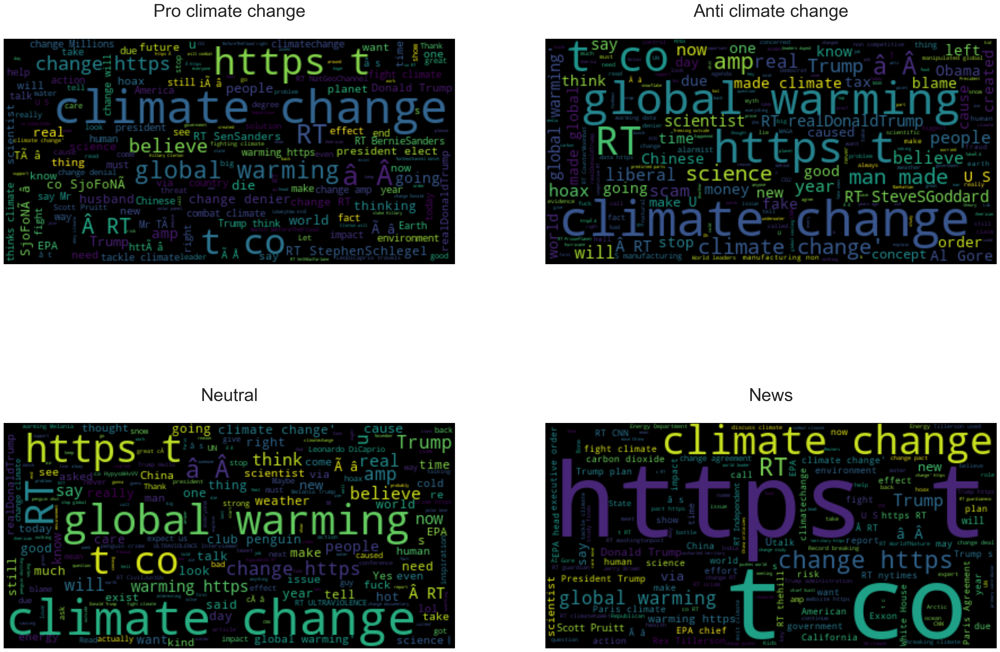

In [41]:
# Plotting pro and anti wordclouds next to one another for comparison
f, axarr = plt.subplots(2,2, figsize=(35,25))
axarr[0,0].imshow(pro_wordcloud, interpolation="bilinear")
axarr[0,1].imshow(anti_wordcloud, interpolation="bilinear")
axarr[1,0].imshow(neutral_wordcloud, interpolation="bilinear")
axarr[1,1].imshow(news_wordcloud, interpolation="bilinear")

# Removing the ticks on the x and y axes
for ax in f.axes:
    plt.sca(ax)
    plt.axis('off')

axarr[0,0].set_title('Pro climate change\n', fontsize=35)
axarr[0,1].set_title('Anti climate change\n', fontsize=35)
axarr[1,0].set_title('Neutral\n', fontsize=35)
axarr[1,1].set_title('News\n', fontsize=35)
#plt.tight_layout()
plt.show()

(-0.5, 399.5, 199.5, -0.5)

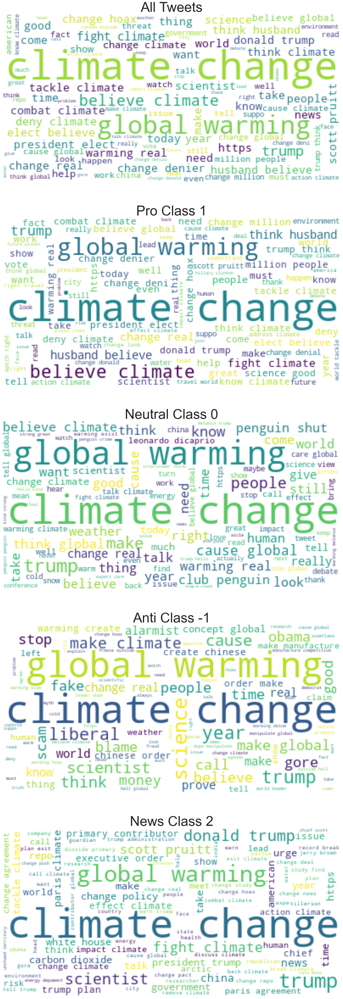

In [42]:
# visualising the messages with word cloud
df_senti1 = train_df[train_df['sentiment'] == 1]
df_senti0 = train_df[train_df['sentiment'] == 0]
df_senti_neg1 = train_df[train_df['sentiment'] == -1]
df_senti2 = train_df[train_df['sentiment'] == 2]
tweet_All = " ".join(review for review in train_df.detokenized_message)
tweet_senti1 = " ".join(review for review in df_senti1.detokenized_message)
tweet_senti0 = " ".join(review for review in df_senti0.detokenized_message)
tweet_senti_neg1 = " ".join(review for review in df_senti_neg1.detokenized_message)
tweet_senti2 = " ".join(review for review in df_senti2.detokenized_message)

fig, ax = plt.subplots(5, 1, figsize=(65, 65))

# Creating and generating a word cloud image
wordcloud_ALL = WordCloud(max_font_size=50, max_words=100,
                          background_color="white").generate(tweet_All)

wordcloud_1 = WordCloud(max_font_size=50, max_words=100,
                        background_color="white").generate(tweet_senti1)

wordcloud_0 = WordCloud(max_font_size=50, max_words=100,
                        background_color="white").generate(tweet_senti0)

wordcloud_neg1 = WordCloud(max_font_size=50, max_words=100,
                           background_color="white").generate(tweet_senti_neg1)

wordcloud_2 = WordCloud(max_font_size=50, max_words=100,
                        background_color="white").generate(tweet_senti2)

# Displaying the generated image
ax[0].imshow(wordcloud_ALL, interpolation='bilinear')
ax[0].set_title('All Tweets', fontsize=50)
ax[0].axis('off')
ax[1].imshow(wordcloud_1, interpolation='bilinear')
ax[1].set_title('Pro Class 1', fontsize=50)
ax[1].axis('off')
ax[2].imshow(wordcloud_0, interpolation='bilinear')
ax[2].set_title('Neutral Class 0', fontsize=50)
ax[2].axis('off')
ax[3].imshow(wordcloud_neg1, interpolation='bilinear')
ax[3].set_title('Anti Class -1', fontsize=50)
ax[3].axis('off')
ax[4].imshow(wordcloud_2, interpolation='bilinear')
ax[4].set_title('News Class 2', fontsize=50)
ax[4].axis('off')

<a id="eight"></a>
## 8. Modelling
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

Now, we can proceed to building our machine learning model. We will split the dataset into training and testing sets, create a feature matrix using vectorization techniques, and train a logistic regression model.
In this section we will do model fitting, meaning we will be training our models using the available data.
When we fit the model we are essentially teaching it to learn patterns, relationships or parameters from the input features and their corresponding target values.

### Train-Test Split
- This stage involves splitting a dataset into two separate subsets: the training set and test set.
- The training set is used to train and build a machine learning model. It is the portion of the data in which the model learns patterns, relationships and underlying structures.
- The test set, on the other hand, is used to evaluate the performance and generalizing the ability of the trained model. The test set allows us to assess how well the model can predict or classify unseen data.
- In our case the 20% of the data will be allocated for testing, and the remaining 80% will be used for training the model."

In [43]:
# Splitting the data into (X) and target variable (y)
X_NB = train_df['detokenized_message']
y = train_df['sentiment']

# vector = TfidfVectorizer(sublinear_tf=True)
vector = TfidfVectorizer(ngram_range=(1,2), min_df=2)
X = vector.fit_transform(X_NB)

model_save_path = "TfidfVectorizer.pkl"

with open(model_save_path, 'wb') as file:
    pickle.dump(vector, file)
    
# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Training various ML Models

### a) Logistic Regression Classification
Logistic regression is a statistical model used for binary classification, where the goal is to predict the probability of an instance belonging to a particular class. It employs the logistic function to map the input features to a probability range between 0 and 1, making it suitable for interpreting and predicting categorical outcomes.

In [44]:
# Logistic Regression model
logreg = LogisticRegression()

# Fitting the model to the training data
logreg.fit(X_train, y_train)

# Making predictions on the training and testing sets
logreg_prediction = logreg.predict(X_test)

# Generating the accuracy score 
logreg_accuracy = accuracy_score(y_test,logreg_prediction)

print("Training accuracy Score: ",logreg.score(X_train,y_train))
print("Testing accuracy Score : ",logreg_accuracy )
print(classification_report(logreg_prediction,y_test))

Training accuracy Score:  0.8294745160015804
Testing accuracy Score :  0.7215549936788875
              precision    recall  f1-score   support

          -1       0.29      0.78      0.42       104
           0       0.33      0.65      0.44       220
           1       0.91      0.72      0.80      2219
           2       0.67      0.76      0.71       621

    accuracy                           0.72      3164
   macro avg       0.55      0.72      0.59      3164
weighted avg       0.80      0.72      0.74      3164



C:\Users\Ayanda Thembelihle\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [45]:
model_save_path = "Random_Forest_Classifier.pkl"
with open(model_save_path, "wb") as file:
    pickle.dump(logreg, file)

### b) Naive Bayes Classification
Naive Bayes classification is a simple probabilistic algorithm that applies Bayes' theorem with the assumption of independence between features. It calculates the probability of a class label given the observed features and selects the most probable class label as the prediction.

In [46]:
# Naive Bayes model
naiveByes_clf = MultinomialNB()
    
# Fitting the model to the training data
naiveByes_clf.fit(X_train,y_train)

# Making predictions on the training and testing sets
NB_prediction = naiveByes_clf.predict(X_test)

# Generating the accuracy score 
NB_accuracy = accuracy_score(y_test,NB_prediction)

print("training accuracy Score: ", naiveByes_clf.score(X_train,y_train))
print("Testing accuracy Score : ", NB_accuracy )
print(classification_report(NB_prediction,y_test))

training accuracy Score:  0.7235084946661399
Testing accuracy Score :  0.6735145385587863
              precision    recall  f1-score   support

          -1       0.11      0.97      0.20        32
           0       0.12      0.75      0.21        69
           1       0.96      0.64      0.77      2615
           2       0.52      0.82      0.64       448

    accuracy                           0.67      3164
   macro avg       0.43      0.80      0.45      3164
weighted avg       0.87      0.67      0.73      3164



### c) Random Forest Classification
Random Forest Classification is a machine learning algorithm that combines multiple decision trees to make predictions. It constructs an ensemble of decision trees by randomly selecting subsets of features and training each tree on different subsets of the data. The final prediction is determined by aggregating the predictions of all individual trees, resulting in a versatile and robust classification model.

In [47]:
# Random Forest model
rf_clf = RandomForestClassifier()

# Fitting the model to the training data
rf_clf.fit(X_train,y_train)

# Making predictions on the training and testing sets
rf_prediction = rf_clf.predict(X_test)

# Generating the accuracy score
rf_accuracy = accuracy_score(y_test,rf_prediction)

print("Training accuracy Score: ",rf_clf.score(X_train,y_train))
print("Testing accuracy Score : ",rf_accuracy )
print(classification_report(rf_prediction,y_test))

Training accuracy Score:  0.9918609245357566
Testing accuracy Score :  0.6912136536030341
              precision    recall  f1-score   support

          -1       0.18      0.80      0.30        64
           0       0.33      0.57      0.42       247
           1       0.91      0.68      0.78      2344
           2       0.56      0.78      0.65       509

    accuracy                           0.69      3164
   macro avg       0.50      0.71      0.54      3164
weighted avg       0.79      0.69      0.72      3164



### d) Linear Support Vector Classifier
Linear Support Vector Classifier (SVC) is a supervised learning algorithm used for binary classification tasks. It seeks to find a hyperplane that maximally separates the instances of different classes in the feature space. It achieves this by constructing a linear decision boundary with a margin, aiming to minimize the classification error. The Linear SVC is particularly effective when the data is linearly separable or nearly separable, and it can also handle high-dimensional datasets efficiently.

In [48]:
# Linear Support Vector model
lsvc_clf = LinearSVC()

# Fitting the model to the training data
lsvc_clf.fit(X_train,y_train)

# Making predictions on the training and testing sets
lsvc_prediction = lsvc_clf.predict(X_test)

# Generating the accuracy score
lsvc_accuracy = accuracy_score(y_test,lsvc_prediction)

print("Training accuracy Score: ",lsvc_clf.score(X_train,y_train))
print("Testing accuracy Score : ",lsvc_accuracy )
print(classification_report(lsvc_prediction,y_test))

Training accuracy Score:  0.9606479652311339
Testing accuracy Score :  0.7155499367888748
              precision    recall  f1-score   support

          -1       0.42      0.67      0.52       174
           0       0.45      0.51      0.48       372
           1       0.83      0.76      0.80      1926
           2       0.70      0.71      0.70       692

    accuracy                           0.72      3164
   macro avg       0.60      0.66      0.62      3164
weighted avg       0.74      0.72      0.72      3164



In [49]:
model_save_path = "Linear_Support_Vector_Classifier.pkl"

with open(model_save_path, 'wb') as file:
    pickle.dump(lsvc_clf, file)

<a id="nine"></a>
## 9. Model Performance
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

After training the model, we need to evaluate its performance. We will calculate the accuracy score and generate a classification report to assess the model's performance on the test set."

### Accuracy

In [50]:
models = pd.DataFrame({
    'Model': [ 'Logistic Regression ',
              'Random Forest', 'Naive Bayes', 'Linear SVC'],
    'Test accuracy': [ logreg_accuracy, 
                      rf_accuracy, NB_accuracy, lsvc_accuracy]})
    
models.sort_values(by='Test accuracy', ascending=False)

,Model,Test accuracy
0,Logistic Regression,0.721555
3,Linear SVC,0.715550
1,Random Forest,0.691214
2,Naive Bayes,0.673515


### Predictions

In [51]:
X_N_test = test_df['detokenized_message']
X_test =vector.transform(X_N_test)

### Dealing with imbalanced data
#### Checking how raw data is distributed

In [52]:
temp = train_df.groupby('sentiment').count()['message'].reset_index().sort_values(by='message',ascending=False)
temp['percentage'] = round((temp['message']/temp['message'].sum())*100,0) #checking for tweet sentiment percetage
temp.style.background_gradient(cmap='Purples')

ImportError: Pandas requires version '3.0.0' or newer of 'jinja2' (version '2.11.3' currently installed).

In [ ]:
# Defining sentiments
Positive = train_df[train_df['sentiment'] == 1]
Negative = train_df[train_df['sentiment'] == -1]
Neutral = train_df[train_df['sentiment'] == 0]
News = train_df[train_df['sentiment'] == 2]

In [ ]:
# Pro sample without replacement, match minority class, reproduce results
Pro_downsampled = resample(Positive, replace=False,
                           n_samples=len(Negative), random_state=27)
# Neutral sample without replacement, match minority class, reproduce results
Neutral_downsampled = resample(Neutral, replace=False,
                               n_samples=len(Negative), random_state=27)
# News sample without replacement, match in minority class, reproduce results
News_downsampled = resample(News, replace=False, 
                            n_samples=len(Negative), random_state=27)
# Combining downsampled majority class with minority class
downsampled = pd.concat([Pro_downsampled, Neutral_downsampled,
                         News_downsampled, Negative])

### Checking downsampled data distribution

In [ ]:
down = downsampled.groupby('sentiment').count()['message'].reset_index().sort_values(by='message',ascending=False)
down['percentage'] = round((down['message']/down['message'].sum())*100,0) #checking for tweet sentiment percetage
down.style.background_gradient(cmap='Purples')

### Modeling the Downsampled Data

In [ ]:
X_d = downsampled['detokenized_message']
y = downsampled['sentiment']

In [ ]:
#vector = TfidfVectorizer(sublinear_tf=True)
vector = TfidfVectorizer(ngram_range=(1,2), min_df=2)
X =vector.fit_transform(X_d)

#### a) Logistic Regression

In [ ]:
log_d = LogisticRegression()

log_d.fit(X_train, y_train)

log_d_prediction = log_d.predict(X_test)
log_d_accuracy = accuracy_score(y_test,log_d_prediction)

print("Training accuracy Score: ",log_d.score(X_train,y_train))
print("Testing accuracy Score : ",log_d_accuracy )
print(classification_report(log_d_prediction,y_test))

In [ ]:
model_save_path = "Logistic_Regression_Classifier.pkl"

with open(model_save_path, 'wb') as file:
    pickle.dump(log_d_prediction, file)

#### b) Naives Bayes

In [ ]:
NB_DS = MultinomialNB()

NB_DS.fit(X_train,y_train)

NB_DS_pred = NB_DS.predict(X_test)

NB_DS_accuracy = accuracy_score(y_test,NB_DS_pred)

print("training accuracy Score: ", NB_DS.score(X_train,y_train))
print("Testing accuracy Score : ", NB_DS_accuracy )
print(classification_report(NB_DS_pred,y_test))

#### c) Random Forest Classifier

In [ ]:
RF_DS = RandomForestClassifier()
RF_DS.fit(X_train,y_train)

RF_DS_pred = RF_DS.predict(X_test)
RF_DS_accuracy = accuracy_score(y_test,RF_DS_pred)

print("Training accuracy Score: ",RF_DS.score(X_train,y_train))
print("Testing accuracy Score : ",RF_DS_accuracy )
print(classification_report(RF_DS_pred,y_test))

#### d) Linear Support Vector Classifier

In [ ]:
lsvc_DS_clf = LinearSVC()

lsvc_DS_clf.fit(X_train,y_train)

lsvc_DS_pred = lsvc_DS_clf.predict(X_test)

lsvc_DS_accuracy = accuracy_score(y_test,lsvc_DS_pred)

print("Training accuracy Score: ",lsvc_DS_clf.score(X_train,y_train))
print("Testing accuracy Score : ",lsvc_DS_accuracy )
print(classification_report(lsvc_DS_pred,y_test))

### Downsampled Data Model Performances

In [ ]:
# Downsampled Data
models = pd.DataFrame({
    'Model Downsampled': [ 'Logistic Regression ', 
              'Random Forest', 'Naive Bayes', 'Linear SVC'],
    'Test accuracy': [ log_d_accuracy, 
              RF_DS_accuracy, NB_DS_accuracy, lsvc_DS_accuracy]})

models.sort_values(by='Test accuracy', ascending=False)

In [ ]:
X_NB_test = test_df['detokenized_message']
X_test = vector.transform(X_NB_test)

In [ ]:
test_pred = log_d.predict(X_test)

test_df['sentiment'] = test_pred

subm = test_df[['tweetid','sentiment']]
subm.to_csv('submission_4.csv', index=False) 

<a id="ten"></a>
## 10. Model Explanation
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

Lastly, we will interpret the trained model to understand which features or words contribute the most to the classification of climate change beliefs. This will provide insights into the factors that influence people's perception of climate change.

<a id="eleven"></a>
## 11. Conclusion
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

1. With regards to our journey in this project our key findings were that 

<a id="twelve"></a>
## 12. References
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

Links to additional resources to help with the understanding of concepts discussed: